In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier

from sklearn.decomposition import PCA
from sklearn.metrics import accuracy_score, f1_score

import category_encoders as ce

import joblib

%matplotlib inline

In [2]:
df = pd.read_csv("dataset\ks-projects-201801.csv")

print('No. of rows:', df.shape[0])
print('No. of columns:',df.shape[1])

No. of rows: 378661
No. of columns: 15


In [3]:
df.head(3)

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
0,1000002330,The Songs of Adelaide & Abullah,Poetry,Publishing,GBP,2015-10-09,1000.0,2015-08-11 12:12:28,0.0,failed,0,GB,0.0,0.0,1533.95
1,1000003930,Greeting From Earth: ZGAC Arts Capsule For ET,Narrative Film,Film & Video,USD,2017-11-01,30000.0,2017-09-02 04:43:57,2421.0,failed,15,US,100.0,2421.0,30000.00
2,1000004038,Where is Hank?,Narrative Film,Film & Video,USD,2013-02-26,45000.0,2013-01-12 00:20:50,220.0,failed,3,US,220.0,220.0,45000.00


# Data cleaning
- Cleaning the target variable:

In [4]:
df['state'].value_counts()

failed        197719
successful    133956
canceled       38779
undefined       3562
live            2799
suspended       1846
Name: state, dtype: int64

In [5]:
#Only keep projects that are either failed or successful

df = df[df['state'].isin(['failed','successful'])]

#Checking target variable counts again

df['state'].value_counts()

failed        197719
successful    133956
Name: state, dtype: int64

* Cleaning null values:

In [6]:
#Check null values
df.isnull().sum()

ID                    0
name                  3
category              0
main_category         0
currency              0
deadline              0
goal                  0
launched              0
pledged               0
state                 0
backers               0
country               0
usd pledged         210
usd_pledged_real      0
usd_goal_real         0
dtype: int64

In [7]:
df = df.dropna()

#Check null values again:

df.isnull().sum()

ID                  0
name                0
category            0
main_category       0
currency            0
deadline            0
goal                0
launched            0
pledged             0
state               0
backers             0
country             0
usd pledged         0
usd_pledged_real    0
usd_goal_real       0
dtype: int64

##  Target variable (State):

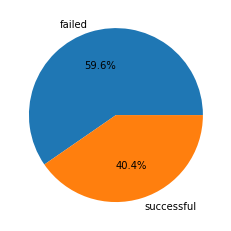

In [8]:
#Show the failure rate of projects

plt.pie(x = df['state'].value_counts(),
        labels = df['state'].value_counts().index,
        autopct='%1.1f%%')

plt.show()

In [9]:
#Convert column values to 1's and 0's by creating dummy columns:

df = pd.get_dummies(data = df,
                    columns = ['state'])

#We only have to keep one column:

df = df.drop('state_failed', axis = 1)


In [10]:
# Project category:

<AxesSubplot:ylabel='main_category'>

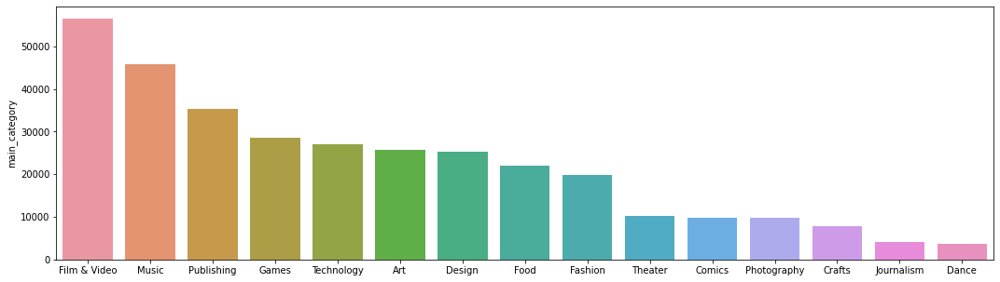

In [11]:
#Check the typical categories for projects

plt.figure(figsize = (18,5))

sns.barplot(x =  df['main_category'].value_counts().index,
            y =  df['main_category'].value_counts())

In [12]:
## Currency that project is paid in:

<AxesSubplot:ylabel='currency'>

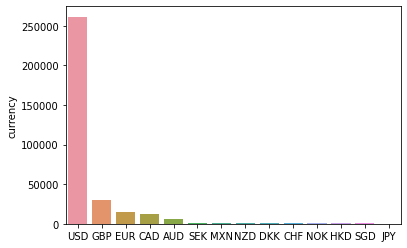

In [13]:
sns.barplot(x = df['currency'].value_counts().index,
            y = df['currency'].value_counts())

In [14]:
df['currency'].value_counts()

USD    261358
GBP     29453
EUR     14357
CAD     12370
AUD      6616
SEK      1509
MXN      1411
NZD      1274
DKK       926
CHF       652
NOK       582
HKD       477
SGD       454
JPY        23
Name: currency, dtype: int64

## Deadlines and launch dates of projects:

In [15]:
df[['deadline','launched']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 331462 entries, 0 to 378660
Data columns (total 2 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   deadline  331462 non-null  object
 1   launched  331462 non-null  object
dtypes: object(2)
memory usage: 7.6+ MB


In [16]:
#Converting datatypes:

df = df.astype({'deadline':'datetime64',
                'launched':'datetime64'
               }
              )

#See if conversion is successful:

df[['deadline','launched']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 331462 entries, 0 to 378660
Data columns (total 2 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   deadline  331462 non-null  datetime64[ns]
 1   launched  331462 non-null  datetime64[ns]
dtypes: datetime64[ns](2)
memory usage: 7.6 MB


In [17]:
# Feature engineering a new column:

In [18]:
#Create a new column showing time between project launch to deadline

time_to_deadline = df['deadline'] - df['launched']
time_to_deadline[:5]

0   58 days 11:47:32
1   59 days 19:16:03
2   44 days 23:39:10
3   29 days 20:35:49
5   34 days 10:21:33
dtype: timedelta64[ns]

In [19]:
#Only keep the number of days to make it simpler, also as int dtype:

time_to_deadline_days = time_to_deadline.dt.days

df['Days to deadline'] = time_to_deadline_days

df['Days to deadline'][:5]

0    58
1    59
2    44
3    29
5    34
Name: Days to deadline, dtype: int64

In [20]:
# Note: Time delta information is stored in pandas in nanoseconds (10^-9).

In [21]:
#Example:

print(time_to_deadline[1:2])
print('\t')
print('Value:', time_to_deadline[1:2].values)
print('\t')
print('Value converted to days:',time_to_deadline[1:2].values /1000 /1000 /1000 #Convert to seconds 
                                                                          /60 #to Minutes
                                                                          /60 #to Hours
                                                                          /24)#to Days

1   59 days 19:16:03
dtype: timedelta64[ns]
	
Value: [5166963000000000]
	
Value converted to days: [59]


C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


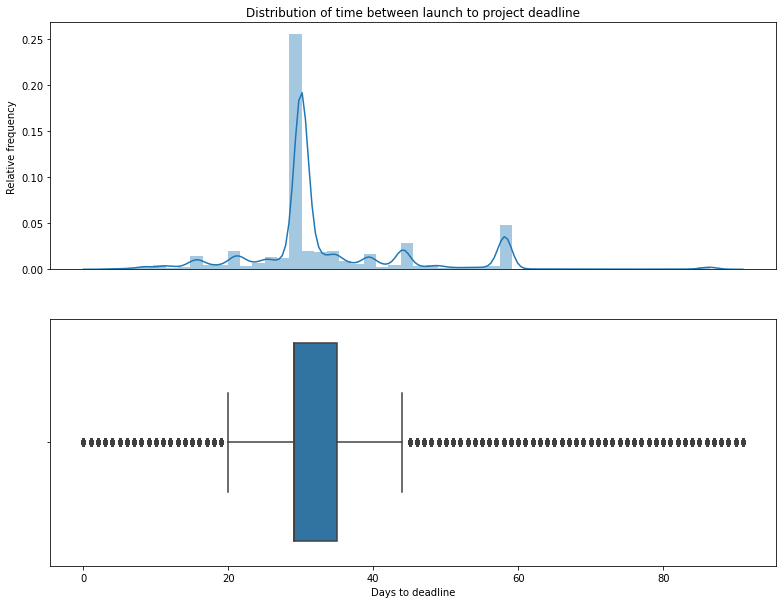

In [22]:
fig, ax = plt.subplots(nrows = 2, ncols = 1, figsize = (13,10))


sns.distplot(df['Days to deadline'],
             ax = ax[0])

sns.boxplot(df['Days to deadline'],
            ax = ax[1])

ax[0].xaxis.set_visible(False)
ax[0].set_title('Distribution of time between launch to project deadline')
ax[0].set_ylabel('Relative frequency')

plt.show()

In [23]:
# Definitely high variation in time to deadline, with most projects falling between 20 to 40 days

In [24]:
df['backers'].describe()

count    331462.000000
mean        116.456315
std         965.732911
min           0.000000
25%           2.000000
50%          15.000000
75%          63.000000
max      219382.000000
Name: backers, dtype: float64

C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


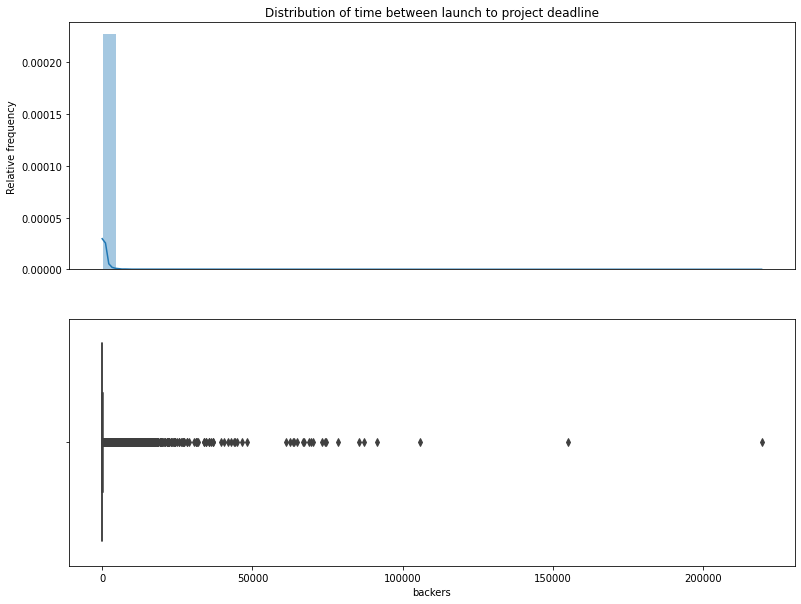

In [25]:
fig, ax = plt.subplots(nrows = 2, ncols = 1, figsize = (13,10))

sns.distplot(df['backers'],
             ax = ax[0])

sns.boxplot(df['backers'],
            ax = ax[1])

ax[0].xaxis.set_visible(False)
ax[0].set_title('Distribution of time between launch to project deadline')
ax[0].set_ylabel('Relative frequency')
plt.show()

In [26]:
#Removing top 2 percentiles of data:

df = df[df['backers'] < np.quantile(df['backers'],0.98)]

In [27]:
#Check the new values:

df['backers'].describe()

#Maximum value is now 908 instead of 219,000 

count    324831.000000
mean         57.207332
std         113.427217
min           0.000000
25%           2.000000
50%          14.000000
75%          58.000000
max         908.000000
Name: backers, dtype: float64

C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


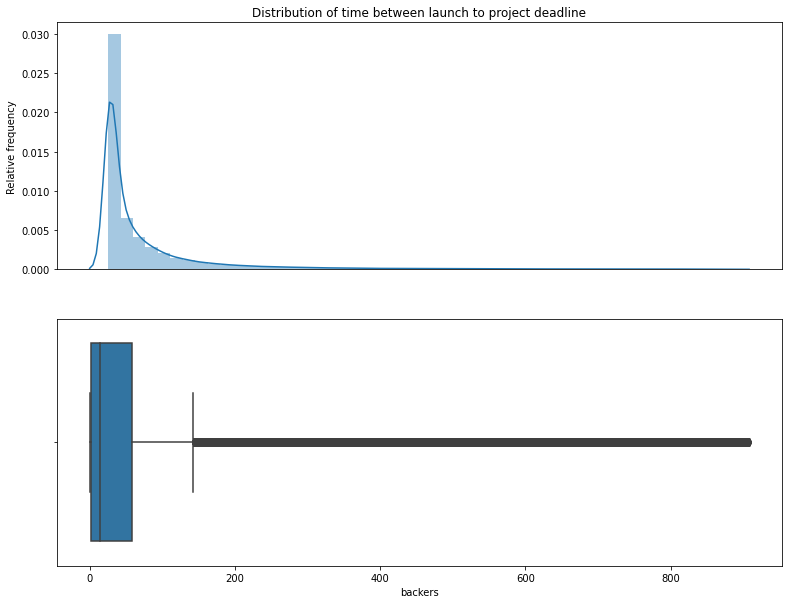

In [28]:
fig, ax = plt.subplots(nrows = 2, ncols = 1, figsize = (13,10))


sns.distplot(df['backers'],
             ax = ax[0])

sns.boxplot(df['backers'],
            ax = ax[1])

ax[0].xaxis.set_visible(False)
ax[0].set_title('Distribution of time between launch to project deadline')
ax[0].set_ylabel('Relative frequency')

plt.show()

In [29]:
# Distribution still looks very skewed, but at least it's not as extreme as before

In [30]:
# Project goals (measured in real USD value):

In [31]:
df['usd_goal_real'].describe()

count    3.248310e+05
mean     4.110891e+04
std      1.119136e+06
min      1.000000e-02
25%      2.000000e+03
50%      5.000000e+03
75%      1.500000e+04
max      1.663614e+08
Name: usd_goal_real, dtype: float64

C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='usd_goal_real', ylabel='Density'>

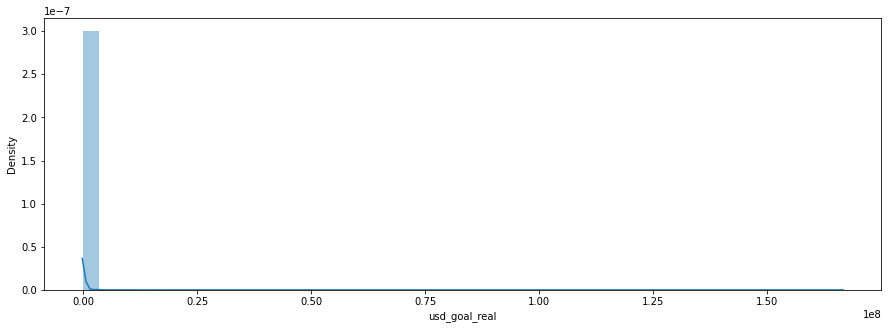

In [32]:
fig, ax = plt.subplots(nrows = 1, ncols = 1, figsize = (15,5))

sns.distplot(df['usd_goal_real'], 
             ax = ax)

In [33]:
#Remove both top and bottom 1 percentile: 

df = df[
         (df['usd_goal_real'] > np.quantile(df['usd_goal_real'],0.01)) & 
         (df['usd_goal_real'] < np.quantile(df['usd_goal_real'],0.99))
                        ]

C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='usd_goal_real', ylabel='Density'>

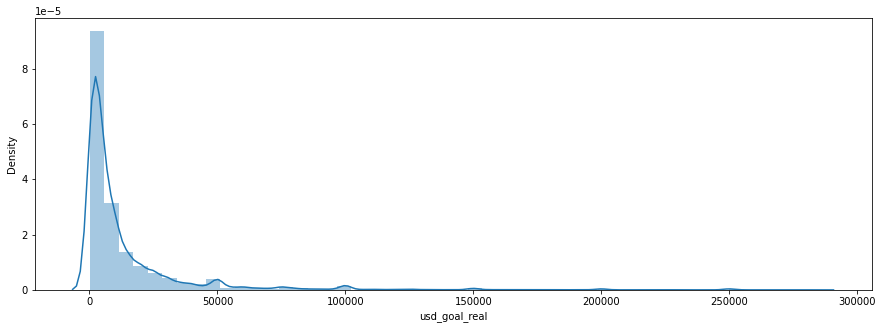

In [34]:
fig, ax = plt.subplots(nrows = 1, ncols = 1, figsize = (15,5))

sns.distplot(df['usd_goal_real'], 
             ax = ax)

In [35]:
#Remove bottom and top 1 percentiles:

df = df[
         (df['usd_pledged_real'] > np.quantile(df['usd_pledged_real'],0.01)) & 
         (df['usd_pledged_real'] < np.quantile(df['usd_pledged_real'],0.99))
                        ]

C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='usd_pledged_real', ylabel='Density'>

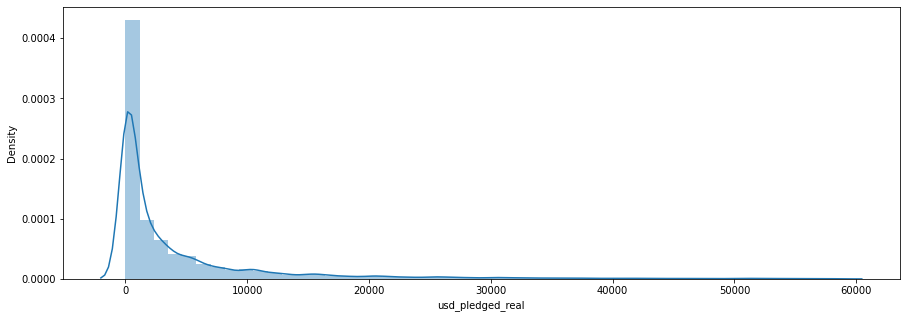

In [36]:
#Checking the distribution again

fig, ax = plt.subplots(nrows = 1, ncols = 1, figsize = (15,5))

sns.distplot(df['usd_pledged_real'], 
             ax = ax)

In [37]:
# Checking 'country':

C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='country', ylabel='count'>

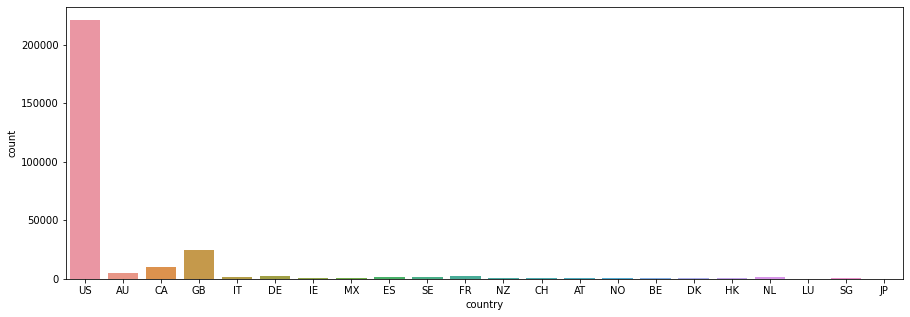

In [38]:
fig, ax = plt.subplots(nrows = 1, ncols = 1, figsize = (15,5))

sns.countplot(df['country'], 
             ax = ax)



In [39]:
df['country'].value_counts()

US    221032
GB     24729
CA      9889
AU      5339
DE      2709
FR      1993
NL      1885
IT      1811
ES      1453
SE      1217
MX      1091
NZ      1066
DK       750
IE       562
CH       494
NO       461
BE       428
HK       389
AT       384
SG       379
LU        48
JP        21
Name: country, dtype: int64

In [40]:
#It seems like most of the projects come from the US
#There are a decent number of projects coming from other countries except JP and LU, so I will drop those countries

df = df[~df['country'].isin(['LU','JP'])]

In [41]:
# Multivariate EDA

In [42]:
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from scipy.stats import f_oneway

In [43]:
numericals = df.select_dtypes(include = ['float64', 'int64'])
categoricals = df.select_dtypes(include = ['object'])

# Constructing a pairplot to see associations between explanatory variables:

In [44]:
import seaborn as sns

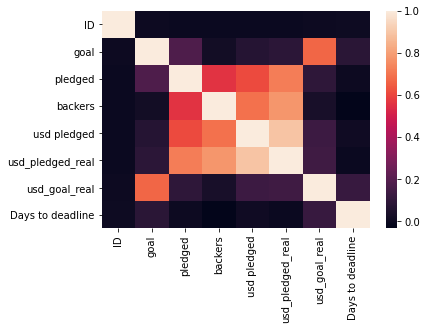

In [45]:
sns.heatmap(numericals.corr())

mask = np.zeros_like(numericals.corr(), dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

In [46]:
# Conducting an ANOVA test between numerical variables and target: 

In [47]:
pd.DataFrame(data = f_classif(numericals, df['state_successful']),
             columns = numericals.columns,
             index = ['F-statistic','p-value'])

,ID,goal,pledged,backers,usd pledged,usd_pledged_real,usd_goal_real,Days to deadline
F-statistic,0.000152,7760.297116,29837.77847,67108.013803,48822.213955,62358.737529,17811.159909,4551.028177
p-value,0.990160,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000


# Conducting a Chi-squared test between categorical variables and target:

In [48]:
from scipy.stats import chi2_contingency

chi2_values = []
p_values = []

for column in categoricals.columns[:-1]:
    contingency = pd.crosstab(df[column], df['state_successful'])

    chi2_val, p_value, degrees_of_freedom, expected = chi2_contingency(contingency)
    
    chi2_values.append(chi2_val)
    p_values.append(p_value)
    
data = list(zip(categoricals.columns, chi2_values, p_values))
pd.DataFrame(data = data,
             columns = ['Variable','Chi squared value','p-value'])

,Variable,Chi squared value,p-value
0,name,276800.438043,0.413757
1,category,26457.831429,0.000000
2,main_category,15931.197884,0.000000
3,currency,1683.267470,0.000000


In [49]:
# Scaling data and PCA

In [50]:
#Reset indexes to prevent some future issues with concatenation:

X = df[['main_category','Days to deadline','usd_goal_real','backers','country']].reset_index(drop = True)
y = df['state_successful'].reset_index(drop = True)

In [51]:
#We use a robust scaler because most of our variables are pretty skewed

#Robust scalers use median and IQR instead of the standard mean and S.D.

from sklearn.preprocessing import RobustScaler 

scaler = RobustScaler()

X_numerical = X.drop(['main_category','country'], axis = 1)

scaler.fit(X_numerical)

scaled_X = scaler.transform(X_numerical)

scaled_X = pd.DataFrame(scaled_X, columns = X_numerical.columns)

In [52]:
# Attempting Principle Component Analysis

In [53]:
from sklearn.decomposition import PCA

#We put n_components as default None so we don't remove any components yet

pca_components = PCA(n_components = None).fit(scaled_X)

#We can see how much variance each Principal Component explains:
for i, variance in enumerate(pca_components.explained_variance_ratio_):
    print('Variance explained by PC{}: {}'.format(i+1, variance))

Variance explained by PC1: 0.4272320503386581
Variance explained by PC2: 0.33281859186193397
Variance explained by PC3: 0.2399493577994081


In [54]:
#After data scaling, I can concatenate my categorical and numerical variables:

X = pd.concat([scaled_X, X[['main_category','country']]],
               join = 'outer', 
               axis = 1
             )

X.head()

,Days to deadline,usd_goal_real,backers,main_category,country
0,5.000000,2.108054,-0.079365,Film & Video,US
1,2.500000,3.372886,-0.269841,Film & Video,US
2,0.000000,0.000000,-0.301587,Music,US
3,0.833333,3.794497,3.238095,Food,US
4,-1.666667,-0.337289,-0.063492,Food,US


In [55]:
#Double check the shape:

X.shape

(278061, 5)

# Creating clusters and encoding variables

In [56]:
%%time

#Attempting to obtain optimal no. of clusters k:

from sklearn.cluster import KMeans

inertias = []

for k in range(3,10):
    kmeans = KMeans(n_clusters = k)
    kmeans.fit(scaled_X)
    inertias.append(kmeans.inertia_)
    

Wall time: 35.2 s


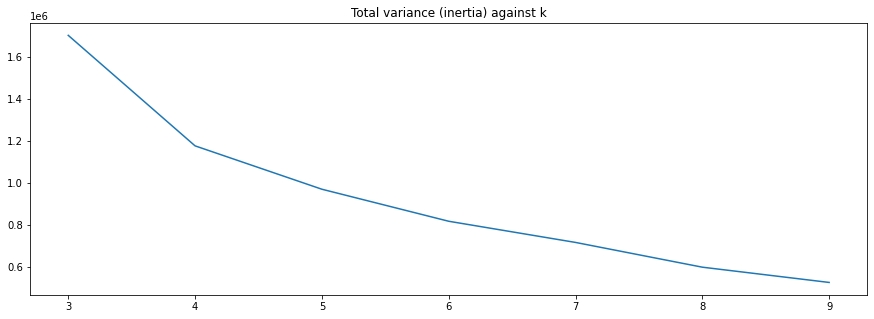

In [57]:
#Plot an inertia vs k graph to visualize the 'elbow':

plt.figure(figsize = (15,5))

sns.lineplot(x = range(3,10),
             y = inertias)

plt.title('Total variance (inertia) against k')
plt.show()

In [58]:
#Creating 4 clusters in the dataset:

kmeans = KMeans(n_clusters = 4)

kmeans_predictions = kmeans.fit_predict(scaled_X)

#Add cluster to features table

X['Cluster (k=4)'] = kmeans_predictions

In [59]:
#Check that clusters are added:

X.head()

,Days to deadline,usd_goal_real,backers,main_category,country,Cluster (k=4)
0,5.000000,2.108054,-0.079365,Film & Video,US,1
1,2.500000,3.372886,-0.269841,Film & Video,US,1
2,0.000000,0.000000,-0.301587,Music,US,0
3,0.833333,3.794497,3.238095,Food,US,2
4,-1.666667,-0.337289,-0.063492,Food,US,0


In [60]:
#  Implementing models

In [61]:
#Using get_dummies would use One-hot encoding, but with high cardinality the data would end up with a high dimension

print('For One-hot encoding:')
print('\t')
print('No. of rows:', pd.get_dummies(X).shape[0])
print('No. of columns:', pd.get_dummies(X).shape[1])

pd.get_dummies(X).head(1)

For One-hot encoding:
	
No. of rows: 278061
No. of columns: 39


,Days to deadline,usd_goal_real,backers,Cluster (k=4),main_category_Art,main_category_Comics,main_category_Crafts,main_category_Dance,main_category_Design,main_category_Fashion,...,country_HK,country_IE,country_IT,country_MX,country_NL,country_NO,country_NZ,country_SE,country_SG,country_US
0,5.0,2.108054,-0.079365,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [62]:
#Using a binary encoder instead might help reduce the dimensionality
#This involves converting to numerical labels, then converting the numbers into binary form

import category_encoders as ce

encoder = ce.BinaryEncoder(cols = ['main_category','country','Cluster (k=4)'])

print('For binary encoding:')
print('\t')
print('No. of rows:', encoder.fit_transform(X).shape[0])
print('No. of columns:', encoder.fit_transform(X).shape[1])

X = encoder.fit_transform(X)

X.head(1)

For binary encoding:
	
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\category_encoders\utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):
No. of rows: 278061
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\category_encoders\utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):
No. of columns: 17
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\category_encoders\utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):


,Days to deadline,usd_goal_real,backers,main_category_0,main_category_1,main_category_2,main_category_3,main_category_4,country_0,country_1,country_2,country_3,country_4,country_5,Cluster (k=4)_0,Cluster (k=4)_1,Cluster (k=4)_2
0,5.0,2.108054,-0.079365,0,0,0,0,1,0,0,0,0,0,1,0,0,1


In [63]:
# Splitting the data:

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, 
                                                    y, 
                                                    test_size=0.33, 
                                                    random_state=42)

In [64]:
#Establish a baseline dummy model to have a benchmark for model accuracy:

from sklearn.dummy import DummyClassifier

baseline = DummyClassifier(strategy = 'stratified')

baseline.fit(X_train,y_train)

baseline_predictions = baseline.predict(X_test)

print('Baseline model accuracy:',accuracy_score(y_test,baseline.predict(X_test)))

Baseline model accuracy: 0.5033728926232277


In [65]:
# Logistic regression

In [66]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

''''
%%time
%%capture

#Measure how long the model takes to fit

#Try a Logistic Regression model:


logmodel = GridSearchCV(estimator = LogisticRegression(),
                        param_grid = {'solver':['sag','lbfgs'],
                                      'C': [0.01,0.1,0.5,1]# Sag is gradient descent
                                     },                    # Lbfgs calculates second derivatives without actually calculating it
                        cv = 5 
                       )
logmodel.fit(X_train,y_train.astype(int))

#joblib.dump(logmodel, './Models/log_model.joblib') #Saving the model for future use:
'''

"'\n%%time\n%%capture\n\n#Measure how long the model takes to fit\n\n#Try a Logistic Regression model:\n\n\nlogmodel = GridSearchCV(estimator = LogisticRegression(),\n                        param_grid = {'solver':['sag','lbfgs'],\n                                      'C': [0.01,0.1,0.5,1]# Sag is gradient descent\n                                     },                    # Lbfgs calculates second derivatives without actually calculating it\n                        cv = 5 \n                       )\nlogmodel.fit(X_train,y_train.astype(int))\n\n#joblib.dump(logmodel, './Models/log_model.joblib') #Saving the model for future use:\n"

In [67]:
#Load previously trained model:

import urllib

logmodel = joblib.load(urllib.request.urlopen('https://github.com/Kesterchia/Predicting-Kickstarter-project-success/blob/main/Models/log_model.joblib?raw=True'))
#Generate predictions:

logmodel_predictions = logmodel.predict(X_test)


C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator LogisticRegression from version 0.23.1 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator GridSearchCV from version 0.23.1 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(


In [68]:
print('Best parameters for Logistic Regression:', logmodel.best_params_)

Best parameters for Logistic Regression: {'C': 0.1, 'solver': 'sag'}


In [69]:
# Support vector machines

In [70]:
%%time 

from sklearn.svm import SVC
import joblib

# svc = SVC().fit(X_train,y_train) #Can't use GridSearchCV, it takes a billion years


#Save model:

# joblib.dump(svc, 'svc_model.joblib')


#Load model and generate predictions:

svc = joblib.load(urllib.request.urlopen('https://github.com/Kesterchia/Predicting-Kickstarter-project-success/blob/main/Models/svc_model.joblib?raw=True'))

svc_predictions = svc.predict(X_test)

C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator SVC from version 0.23.1 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(
Wall time: 2min 42s


In [71]:
# Decision Tree

In [72]:
%%time
%%capture

from sklearn.tree import DecisionTreeClassifier

tree = GridSearchCV(estimator = DecisionTreeClassifier(),
                    param_grid = {'criterion':["gini", "entropy"],
                                 },
                    cv = 5 #Default 5-fold CV
                   )
tree.fit(X_train,y_train)

#Generate predictions:

tree_predictions = tree.predict(X_test)

Wall time: 10.5 s


In [73]:
print('Criterion choice for decision tree:',tree.best_params_)

Criterion choice for decision tree: {'criterion': 'entropy'}


In [74]:
# Random forest (Ensemble of decision trees) (Removed because forest.joblib was >700MB)

In [75]:
%%time

from sklearn.ensemble import RandomForestClassifier

# forest = GridSearchCV(RandomForestClassifier(),
#                    param_grid = {'n_estimators' : [100,200,300],
#                                  'max_features' : ['auto'] #Default
#                                 }                                               
#                     )
# forest.fit(X_train,y_train)

# joblib.dump(forest, 'forest_model.joblib')

# forest = joblib.load('./Models/forest_model.joblib')
                     
#Generate predictions

# forest_predictions = forest.predict(X_test)

Wall time: 27.9 ms


In [76]:
# forest.best_params

In [77]:
# Adaboost classification (Forest of stumps)

In [78]:
from sklearn.ensemble import AdaBoostClassifier

# adaboost_cv = GridSearchCV(estimator = AdaBoostClassifier(),
                               #param_grid = {'n_estimators' : [50,100,200],
                                             #'learning_rate' : [0.2,0.5,0.8,1.0]})

# adaboost_cv.fit(X_train,y_train)

# Save Adaboost classifier object:

# joblib.dump(adaboost_cv, 'adaboost_model.joblib')


#Load adaboost model:

adaboost_cv = joblib.load(urllib.request.urlopen('https://github.com/Kesterchia/Predicting-Kickstarter-project-success/blob/main/Models/adaboost_model.joblib?raw=True'))

#Generate predictions:
adaboost_cv_predictions = adaboost_cv.predict(X_test)

C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator AdaBoostClassifier from version 0.23.1 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator DecisionTreeClassifier from version 0.23.1 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator GridSearchCV from version 0.23.1 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(


In [79]:
print('Best parameters for Adaboost Classifier:', adaboost_cv.best_params_)

Best parameters for Adaboost Classifier: {'learning_rate': 0.2, 'n_estimators': 200}


In [80]:
# Evaluating models

In [81]:
%%time

#Calculate a few metrics for the models and put them in a table:

from sklearn.metrics import accuracy_score, precision_score, recall_score, plot_confusion_matrix, plot_roc_curve,classification_report

model_names = ['Logistic Regression', 'Support vector machines', 'Decision tree', 'Adaboost', 'Baseline (Stratified)']

models = [logmodel, svc, tree, adaboost_cv, baseline]

predictions = [logmodel_predictions, svc_predictions, tree_predictions, adaboost_cv_predictions, baseline_predictions]

training_accuracy_scores = [model.score(X_train,y_train) for model in models]

test_accuracy_scores = [accuracy_score(y_test,predictions[i]) for i,model in enumerate(models)]

precisions = [precision_score(y_test,predictions[i]) for i,model in enumerate(models)]

recalls = [recall_score(y_test, predictions[i]) for i,model in enumerate(models)]

f1_scores = [f1_score(y_test,predictions[i]) for i,model in enumerate(models)]

cross_validated = ['Yes','No','Yes','Yes','Yes','No']

Wall time: 4min 50s


In [82]:
datapoints = zip(model_names, training_accuracy_scores, test_accuracy_scores, precisions, recalls, f1_scores, cross_validated)

pd.DataFrame(data = datapoints,
             columns = ['Model','Training accuracy', 'Test accuracy', 'Precision', 'Recall','F1_score', 'Cross validated?'])

,Model,Training accuracy,Test accuracy,Precision,Recall,F1_score,Cross validated?
0,Logistic Regression,0.904697,0.902954,0.916096,0.858214,0.886211,Yes
1,Support vector machines,0.879291,0.877214,0.931574,0.778325,0.848082,No
2,Decision tree,0.988427,0.890073,0.880634,0.868015,0.874279,Yes
3,Adaboost,0.899705,0.897298,0.931120,0.828021,0.876549,Yes
4,Baseline (Stratified),0.506350,0.509955,0.443425,0.442360,0.442892,Yes


In [83]:
# Plotting confusion matrices for each model

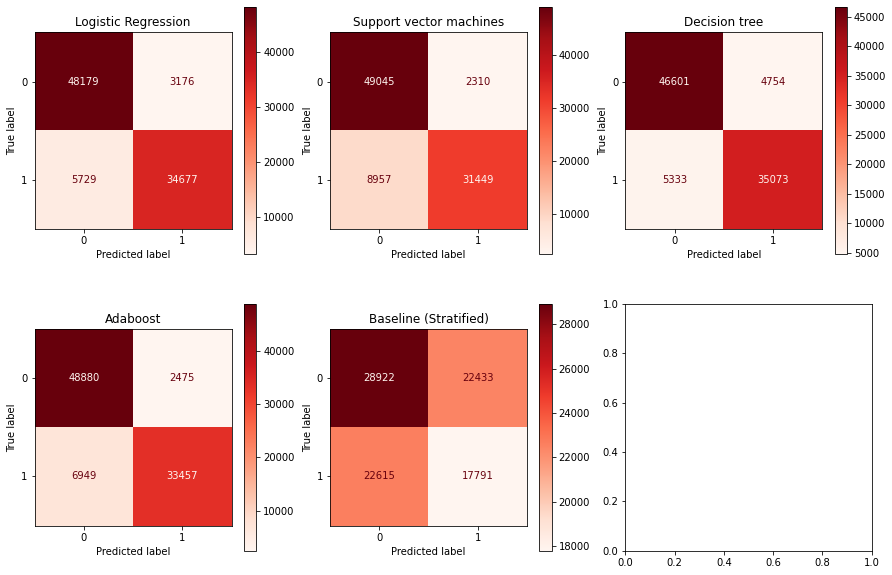

In [84]:
fig, axes = plt.subplots(nrows = 2, ncols = 3, figsize = (15,10))

for model, axis, modelname in zip(models,axes.flatten(), model_names):
    plot_confusion_matrix(estimator = model,
                          X = X_test,
                          y_true = y_test,
                          cmap = 'Reds',
                          ax = axis,)
    axis.set_title(modelname)
    axis.grid(False)

In [85]:
models

[GridSearchCV(cv=5, estimator=LogisticRegression(),
              param_grid={'C': [0.01, 0.1, 0.5, 1], 'solver': ['sag', 'lbfgs']}),
 SVC(),
 GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
              param_grid={'criterion': ['gini', 'entropy']}),
 GridSearchCV(estimator=AdaBoostClassifier(),
              param_grid={'learning_rate': [0.2, 0.5, 0.8, 1.0],
                          'n_estimators': [50, 100, 200]}),
 DummyClassifier(strategy='stratified')]

In [86]:
# Plotting ROC curves for each model

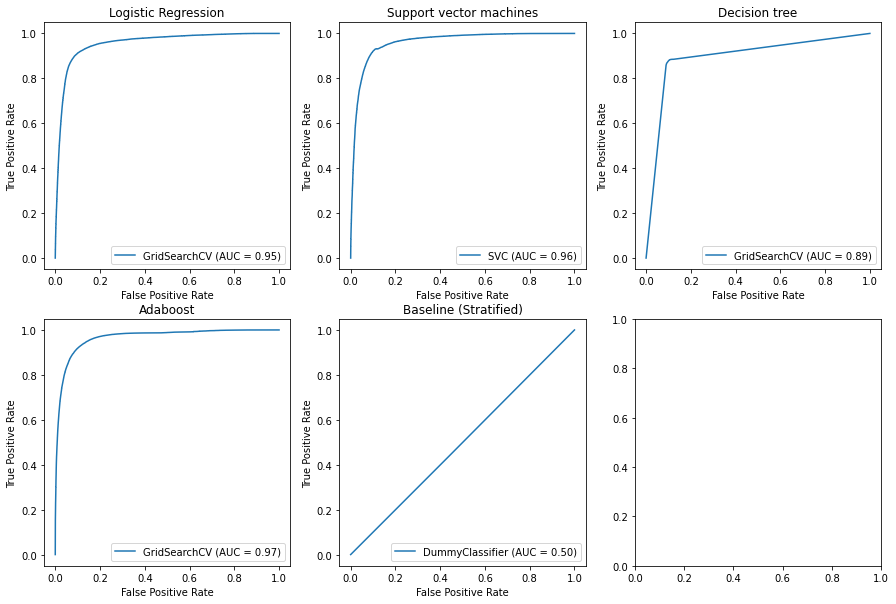

In [87]:
fig, axes = plt.subplots(nrows = 2, ncols = 3, figsize = (15,10))

for model, axis, modelname in zip(models,axes.flatten(), model_names):
    plot_roc_curve(estimator = model,
                          X = X_test,
                          y = y_test,
                          ax = axis,)
    axis.set_title(modelname)

In [88]:
# Making a tool to estimate how many backers a project would need

In [89]:
#Predict_proba function returns the probability of 0 and 1 as outcomes

sample = X.sample(1)

#To access probability that the project is successful:

print('Project probability of success:', adaboost_cv.predict_proba(sample)[0][1])

Project probability of success: 0.5021012432123959


In [90]:
# Defining a function to return success probabilities

In [91]:
#First create a function that returns the success probability (using logistic regression)

def predict_project_success(data, model):

    #Scale data

    X_numerical = data[['Days to deadline','usd_goal_real','backers']]
    scaled_X = pd.DataFrame(scaler.transform(X_numerical), columns = X_numerical.columns)

    scaled_X
    #Cluster data

    clusters = pd.DataFrame(kmeans.predict(scaled_X), columns = ['Cluster (k=4)'])

    # Concatenate categorical and numerical variables

    X = pd.concat([scaled_X, clusters, data[['main_category','country']].reset_index(drop = True)], axis = 1,)
    #Encode X

    encoded_X = encoder.transform(X)

    encoded_X

    #Generate prediction probability

    return (model.predict_proba(encoded_X)[0][1]) #Probability estimate that project is successful

In [92]:
#Take a sample of the data:

sample = df.sample(1)
sample

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,backers,country,usd pledged,usd_pledged_real,usd_goal_real,state_successful,Days to deadline
212446,2082764835,Shepherd: Graphic Novel,Graphic Novels,Comics,AUD,2014-07-10,17000.0,2014-06-10 05:21:06,6903.0,141,AU,6442.64,6489.0,15980.45,0,29


In [121]:
df.country.unique().tolist()

['US',
 'AU',
 'CA',
 'GB',
 'IT',
 'DE',
 'IE',
 'MX',
 'ES',
 'SE',
 'FR',
 'NZ',
 'CH',
 'AT',
 'NO',
 'BE',
 'DK',
 'HK',
 'NL',
 'SG']

In [93]:
#Predicted success probability of sample:

print('Predicted success probability:',predict_project_success(sample,adaboost_cv))

Predicted success probability: 0.5076226579143299


In [94]:
import pickle
model_dict ={'model':adaboost_cv,'encoder':encoder,'scaler':scaler,'sample':sample,'description':'success prediction model','kmeans':kmeans}
with open('crowdfunding_prediction.pk','wb') as file:
    pickle.dump(model_dict,file)
    

In [95]:
model_names

['Logistic Regression',
 'Support vector machines',
 'Decision tree',
 'Adaboost',
 'Baseline (Stratified)']

In [96]:
with open("all_models.pk",'wb') as file:
    pickle.dump((models,model_names),file)

In [97]:
# Subsequently, defining a second function that generates a plot of project success probability against no. of backers:

In [98]:
#Define function to generate a plot of expected data

def plot_success_graph(model,days, goal, category, country, max_backers):
    
    
    '''
    This function plots a graph of an estimate of the project's success given an arbitrary amount of backers.
    
    Arguments:
    
    days: Total number of days from the project's launch to the deadline of completion.
    
    goal: The monetary goal of the project in USD.
    
    category: The category that the project falls under. Must be in: ['Publishing', 'Film & Video', 'Music', 'Food', 'Crafts',
    'Games','Design', 'Comics', 'Fashion', 'Theater', 'Art', 'Photography','Technology', 'Dance', 'Journalism']
    
    country: Country of the project's origin. Must be in: ['GB', 'US', 'CA', 'AU', 'IT', 'DE', 'IE', 'MX', 'ES', 'SE', 'FR',
       'NZ', 'CH', 'AT', 'NO', 'BE', 'DK', 'HK', 'NL', 'SG']
       
    max_backers: Maximum backers limit for model to estimate till (Model starts with 0, step size = 20).
    
    '''
    
    
    data = pd.DataFrame(columns = ['Days to deadline','usd_goal_real','main_category','country'],
                        data = [[days,goal,category,country]])
    probabilities = []
    for i in np.arange(0,max_backers,5):
        data.loc[:,'backers'] = i
        probability_success = predict_project_success(data,model)
        probabilities.append(probability_success)
    
    plt.figure(figsize = (20,5))
    
    sns.set_style('darkgrid')
    
    sns.lineplot(y = probabilities,
                 x = np.arange(0,max_backers,5))
    
    plt.xlabel('No. of backers', fontdict = {'fontsize':15})
    plt.xticks(np.arange(0,max_backers,step = 25))
    
    plt.ylabel('Probability of success', fontdict = {'fontsize':15})
    
    plt.title('Probability of project success by backers', fontdict = {'fontsize':15})
    
    plt.show()


In [99]:
# Some examples of the function being used

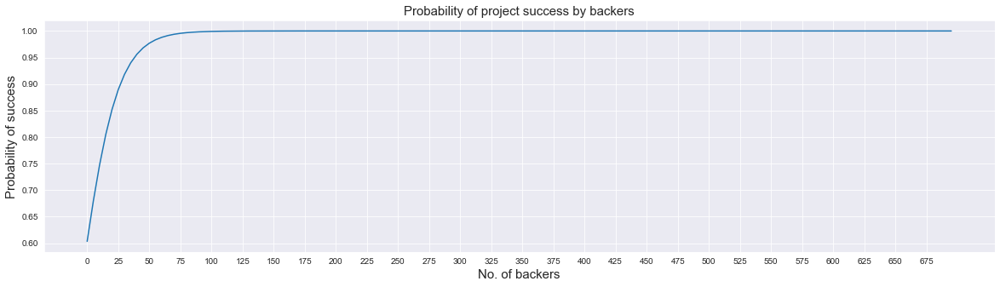

In [100]:
#Example of the function on some test data:

#Using the logistic regression model:

plot_success_graph(model = logmodel,
                   days = 50, 
                   goal = 10000, 
                   category = 'Games', 
                   country = 'NZ', 
                   max_backers = 700)

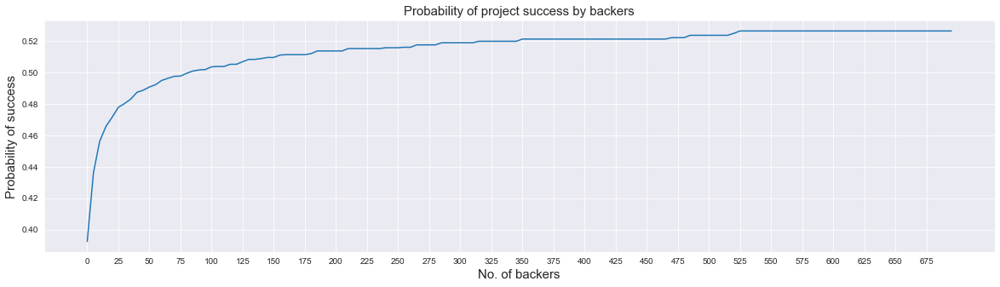

In [101]:
#Using the AdaBoost model:

plot_success_graph(model = adaboost_cv,
                   days = 50, 
                   goal = 10000, 
                   category = 'Games', 
                   country = 'NZ', 
                   max_backers = 700)

#Probabilities are alot more constrained below 0.5, is it because Adaboost predict_probas cannot be interpreted as probabilities?

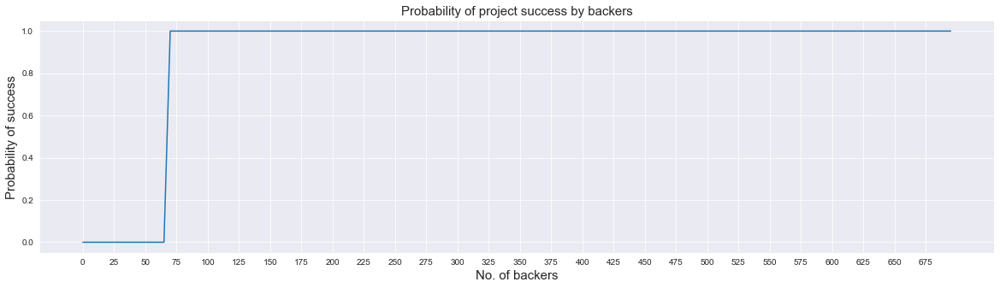

In [102]:
#Using the decision tree model:

plot_success_graph(model = tree,
                   days = 50, 
                   goal = 10000, 
                   category = 'Games', 
                   country = 'NZ', 
                   max_backers = 700)

#Even worse! The probabilities make no sense

In [103]:
# Trying to fix the issue by calibrating the predict_proba output of the AdaBoost model:

In [104]:
from sklearn.calibration import CalibratedClassifierCV


#Create model to calculate calibrated probabilities:

#calibrated_adaboost = CalibratedClassifierCV(base_estimator = adaboost_cv,
#                                             cv = None, #Default is 5-fold
#                                             method = 'isotonic', #Isotonic regression
#                                            )

#Fit calibrated model:

# calibrated_adaboost.fit(X_train,y_train) (Took 1 hour 16 min)

In [105]:
#Save calibrated model locally:

#joblib.dump(calibrated_adaboost, 'calibrated_adaboost_model.joblib')


#Load calibrated model:

calibrated_adaboost_cv = joblib.load(urllib.request.urlopen('https://github.com/Kesterchia/Predicting-Kickstarter-project-success/blob/main/Models/calibrated_adaboost_model.joblib?raw=True'))

C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator AdaBoostClassifier from version 0.23.1 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator DecisionTreeClassifier from version 0.23.1 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle estimator GridSearchCV from version 0.23.1 when using version 0.23.2. This might lead to breaking code or invalid results. Use at your own risk.
  warnings.warn(
C:\Users\asus\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:329: UserWarning: Trying to unpickle es

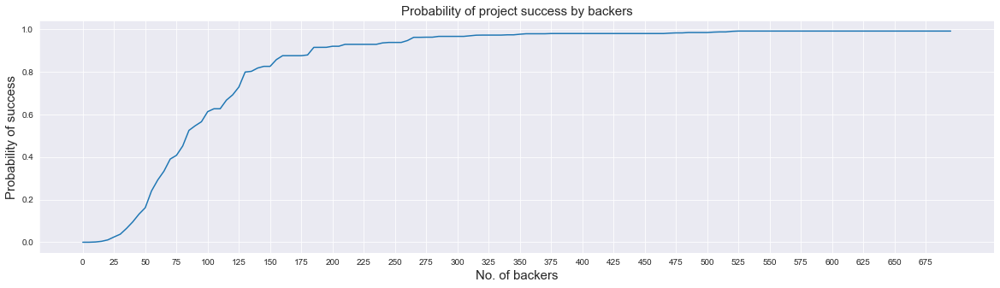

In [106]:
#Using the calibrated AdaBoost model:

plot_success_graph(model = calibrated_adaboost_cv,
                   days = 50, 
                   goal = 10000, 
                   category = 'Games', 
                   country = 'NZ', 
                   max_backers = 700)

#Probabilities are alot more constrained below 0.5, is it because Adaboost predict_probas cannot be interpreted as probabilities?

In [107]:
model

DummyClassifier(strategy='stratified')

In [108]:
df.columns.tolist()

['ID',
 'name',
 'category',
 'main_category',
 'currency',
 'deadline',
 'goal',
 'launched',
 'pledged',
 'backers',
 'country',
 'usd pledged',
 'usd_pledged_real',
 'usd_goal_real',
 'state_successful',
 'Days to deadline']

In [110]:
df["usd pledged"].describe()

count    278061.000000
mean       3711.360086
std        7361.863223
min           0.000000
25%          90.000000
50%         758.000000
75%        3683.000000
max       71329.000000
Name: usd pledged, dtype: float64

In [112]:
features = np.array([[ID,name,category,main_category,currency,deadline,goal,launched,pledged,backers,country,usd pledged,usd_pledged_real,usd_goal_real,state_successful,Days to deadline]])

SyntaxError: invalid syntax (<ipython-input-112-ab3ba4849f5b>, line 1)

In [114]:
df.main_category.unique().tolist()

['Film & Video',
 'Music',
 'Food',
 'Design',
 'Comics',
 'Publishing',
 'Fashion',
 'Theater',
 'Art',
 'Photography',
 'Games',
 'Crafts',
 'Technology',
 'Journalism',
 'Dance']

In [3]:
def avg(*nums):
    sum=0
    for i in range(len(nums)):
        sum=sum+nums[i]
    res=sum/len(nums)
    print(float(res))
nums=[2,5]
avg(*nums)

3.5
